## Libraries

In [1]:
%matplotlib inline

import os

import numpy as np
import scipy.stats as stats

import matplotlib as mpl
import matplotlib.pyplot as plt

import cv2
from scipy import ndimage as ndi
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed, random_walker
from skimage.feature import peak_local_max
from skimage.segmentation import mark_boundaries
from skimage.filters import sobel

import Annotation_functions as af

## Importing image

In [2]:
bacteria = cv2.imread('test_input_1.bmp')

## Inspecting image

In [3]:
bacteria[:,:,0].flatten()

array([150, 150, 150, ..., 186, 186, 192], dtype=uint8)

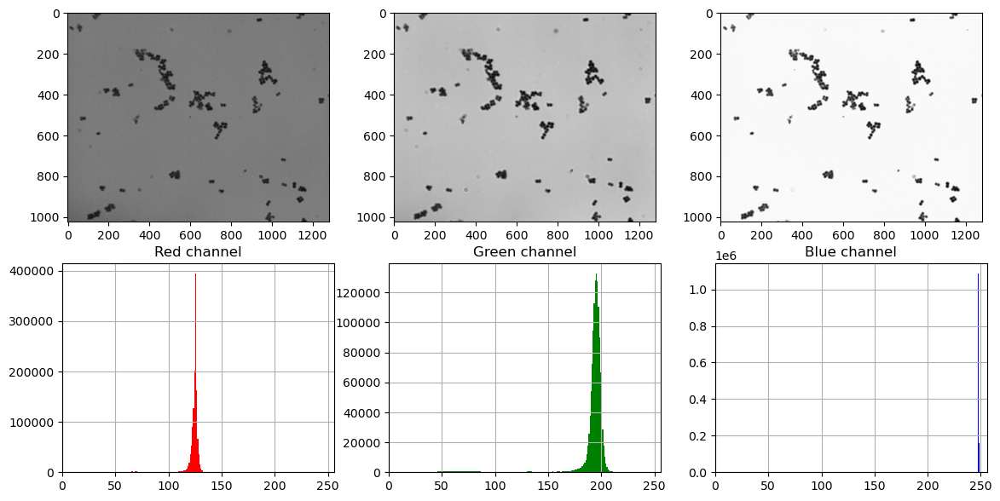

In [33]:
bacteria = cv2.imread('test_input_5.bmp')

fig, axs = plt.subplots(2, 3, figsize=(14*1,7*1))

axs[0,0].imshow(bacteria[:,:,0], cmap=plt.cm.gray)
axs[0,1].imshow(bacteria[:,:,1], cmap=plt.cm.gray)
axs[0,2].imshow(bacteria[:,:,2], cmap=plt.cm.gray)

axs[1,0].hist(bacteria[:,:,0].flatten(), bins=[el for el in range(256)], range=(0,256), color='r')
axs[1,0].set_xlim((0, 256))
axs[1,0].set_title("Red channel")
axs[1,0].grid()

axs[1,1].hist(bacteria[:,:,1].flatten(), bins=[el for el in range(256)], range=(0,256), color='g')
axs[1,1].set_xlim((0, 256))
axs[1,1].set_title("Green channel")
axs[1,1].grid()

axs[1,2].hist(bacteria[:,:,2].flatten(), bins=[el for el in range(256)], range=(0,256), color='b')
axs[1,2].set_xlim((0, 256))
axs[1,2].set_title("Blue channel")
axs[1,2].grid()

plt.show()

In [5]:
one_channel_bacteria = af.select_colorsp(bacteria, "gray")
one_channel_bacteria.shape

(1216, 1616)

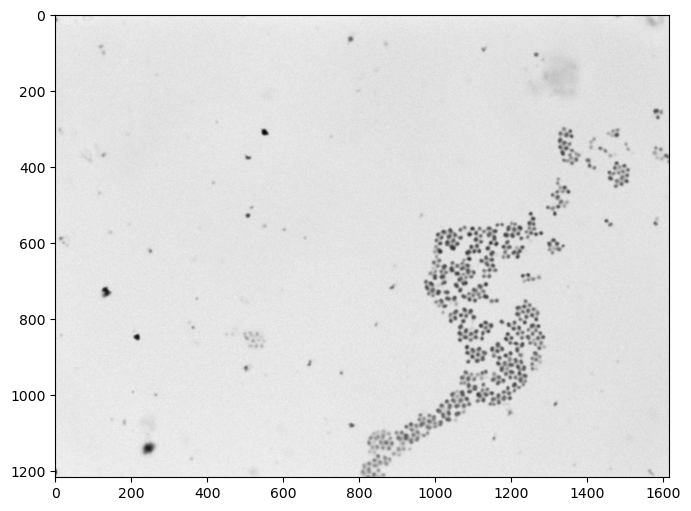

In [6]:
fig, axs = plt.subplots(1, 1, figsize=(17,6))
axs.imshow(one_channel_bacteria, cmap=plt.cm.gray)

Text(0.5, 1.0, 'One channel')

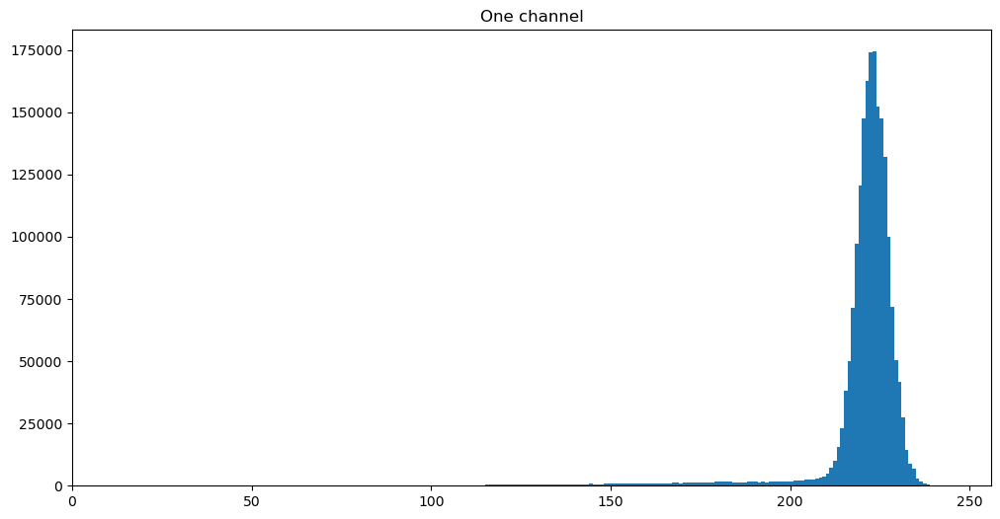

In [7]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")

## Segmenting with watershed

Text(0.5, 1.0, 'Sobel')

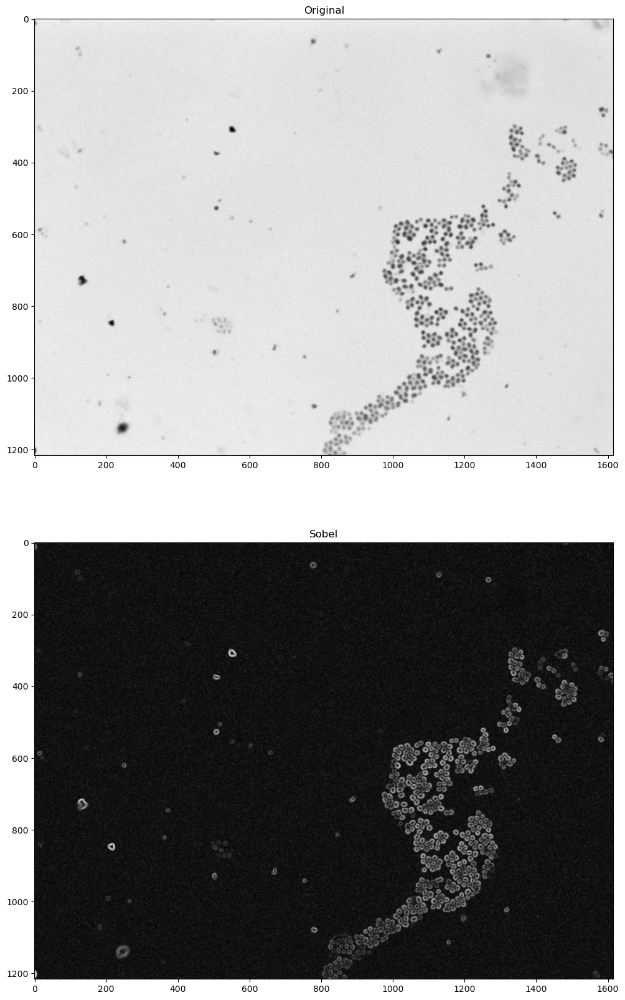

In [8]:
fig, axs = plt.subplots(2, 1, figsize=(16,20))
axs[0].imshow(one_channel_bacteria, cmap=plt.cm.gray)
axs[0].set_title('Original')
axs[1].imshow(sobel(one_channel_bacteria), cmap=plt.cm.gray)
axs[1].set_title('Sobel')

In [9]:
# one_channel_bacteria_labels = watershed(sobel(one_channel_bacteria))
one_channel_bacteria_labels = watershed(one_channel_bacteria)

In [10]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[  1749,   1749,   1749, ...,    450,    450,    450],
       [  1749,   1749,   1749, ...,    450,    450,    450],
       [  1749,   1749,   1749, ...,    450,    450,    450],
       ...,
       [172501, 172501, 172501, ..., 173950, 173950, 173950],
       [172501, 172501, 172501, ..., 174239, 174239, 174239],
       [172501, 172501, 172501, ..., 174239, 174239, 174239]])

In [11]:
np.max(one_channel_bacteria_labels)

174443

Text(0.5, 1.0, 'Watershed')

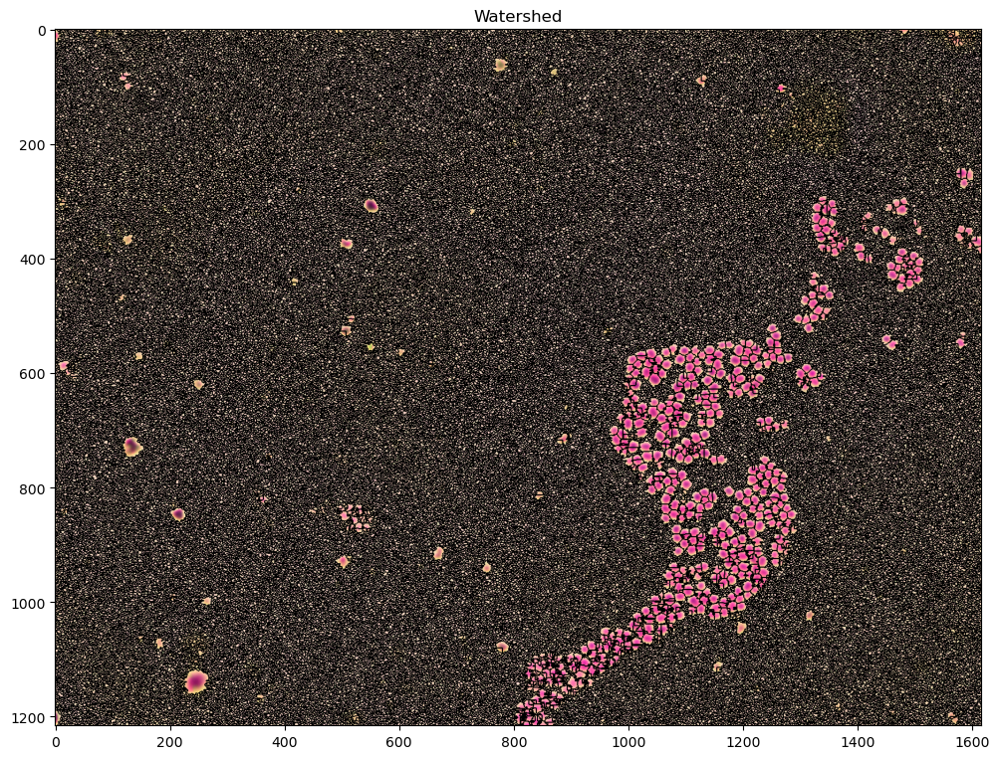

In [12]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('Watershed')

In [13]:
# values, counts = np.unique(one_channel_bacteria_labels, return_counts=True)
# dtype = [('values', int), ('counts', int)]
# values_counts = np.array([(val, cnt) for val, cnt in zip(values, counts)], dtype=dtype)
# values_counts_sorted = np.sort(values_counts, order = 'counts')[::-1]
# values_counts_sorted

In [14]:
# fig, axs = plt.subplots(3, 3, figsize=(17, 10))

# for i in range(3):
#     for j in range(3):
#         one_channel_bacteria_copy = one_channel_bacteria.copy()
#         for i_i in range(one_channel_bacteria_copy.shape[0]):
#             for i_j in range(one_channel_bacteria_copy.shape[1]):
#                 if one_channel_bacteria_labels[i_i][i_j] == values_counts_sorted[int(j + i*3)][0]:
#                     one_channel_bacteria_copy[i_i][i_j] = 255
        
#         axs[i][j].imshow(one_channel_bacteria_copy, cmap=plt.cm.gray)
#         axs[i][j].set_title(f"Label {values_counts_sorted[int(j + i*3)]}")

In [15]:
# labels_num = 200

# fig, axs = plt.subplots(1, 1, figsize=(17, 10))

# one_channel_bacteria_copy = one_channel_bacteria.copy()
# checked_labels =[el for el,_ in values_counts_sorted[:labels_num]]
# for i_i in range(one_channel_bacteria_copy.shape[0]):
#     for i_j in range(one_channel_bacteria_copy.shape[1]):
#         if one_channel_bacteria_labels[i_i][i_j] in checked_labels:
#             one_channel_bacteria_copy[i_i][i_j] = 255

# axs.imshow(one_channel_bacteria_copy, cmap=plt.cm.gray)
# axs.set_title(f"First {labels_num} labels")

## Segmenting with Felzenszwalbs's method

In [16]:
one_channel_bacteria_labels = felzenszwalb(bacteria, scale = 2)

In [17]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[    0,     0,     0, ...,    82,    82,    82],
       [   83,    83,    83, ...,    82,    82,    82],
       [   83,    83,    83, ...,   196,   196,   196],
       ...,
       [26958, 26958, 26958, ..., 27390, 27390, 27390],
       [26958, 26958, 27177, ..., 27390, 27390, 27390],
       [27177, 27177, 27177, ..., 27390, 27390, 27390]], dtype=int64)

In [18]:
np.max(one_channel_bacteria_labels)

27397

Text(0.5, 1.0, "Felzenszwalbs's method")

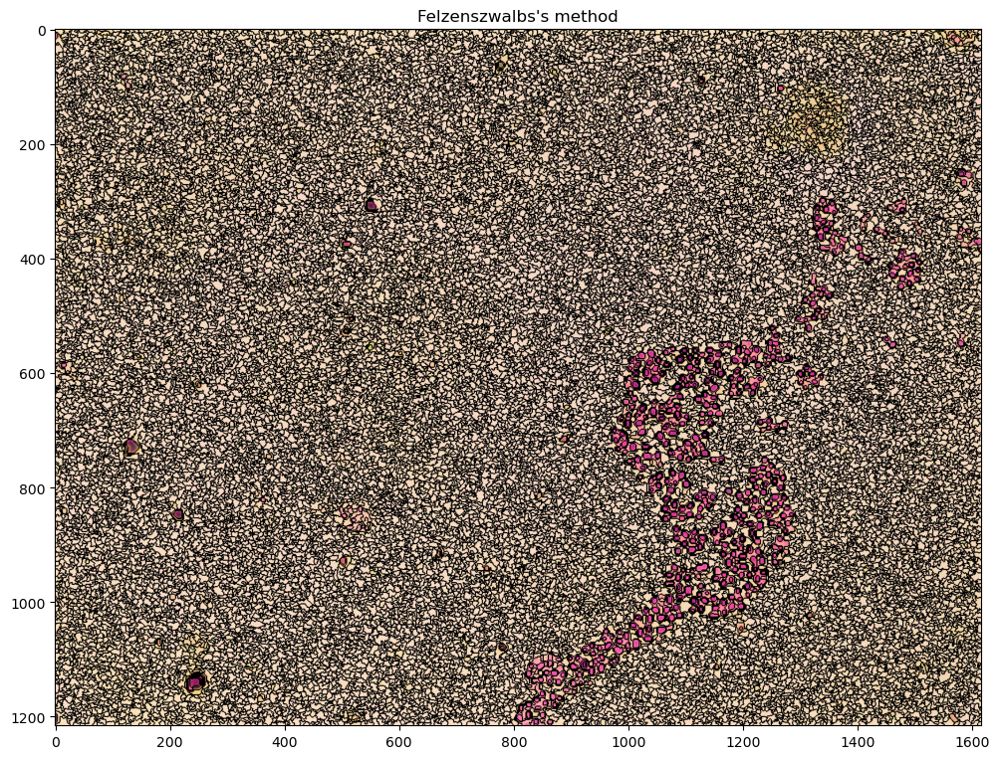

In [19]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('Felzenszwalbs\'s method')

## Segmenting with SLIC

In [20]:
one_channel_bacteria_labels = slic(bacteria, n_segments=1000)

In [21]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[  1,   1,   1, ...,  12,  12,  12],
       [  1,   1,   1, ...,  12,  12,  12],
       [  1,   1,   1, ...,  12,  12,  12],
       ...,
       [429, 429, 429, ..., 440, 440, 440],
       [429, 429, 429, ..., 440, 440, 440],
       [429, 429, 429, ..., 440, 440, 440]], dtype=int64)

In [22]:
np.max(one_channel_bacteria_labels)

447

Text(0.5, 1.0, 'SLIC')

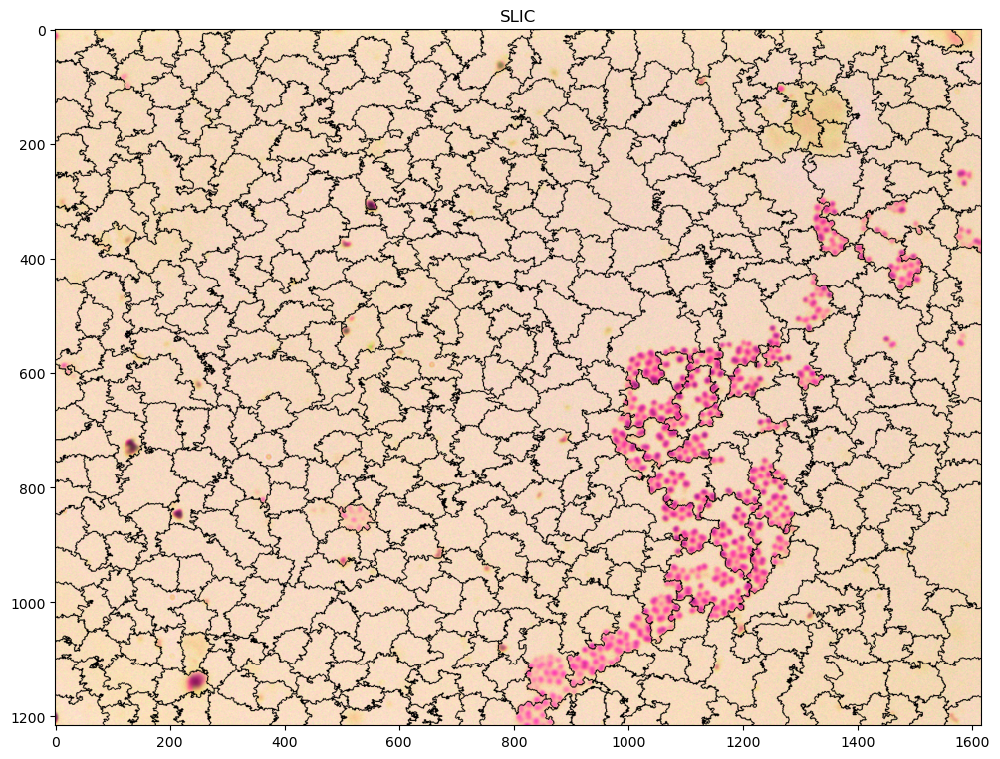

In [23]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('SLIC')

## Segmenting with Quickshift

In [24]:
one_channel_bacteria_labels = quickshift(bacteria)

In [25]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[  13,   13,   13, ...,  118,  118,  118],
       [  13,   13,   13, ...,  118,  118,  118],
       [  13,   13,   13, ...,  118,  118,  118],
       ...,
       [4209, 4209, 4130, ..., 4157, 4157, 4157],
       [4204, 4130, 4130, ..., 4157, 4157, 4157],
       [4130, 4130, 4130, ..., 4157, 4157, 4157]], dtype=int64)

In [26]:
np.max(one_channel_bacteria_labels)

4215

Text(0.5, 1.0, 'Quickshift')

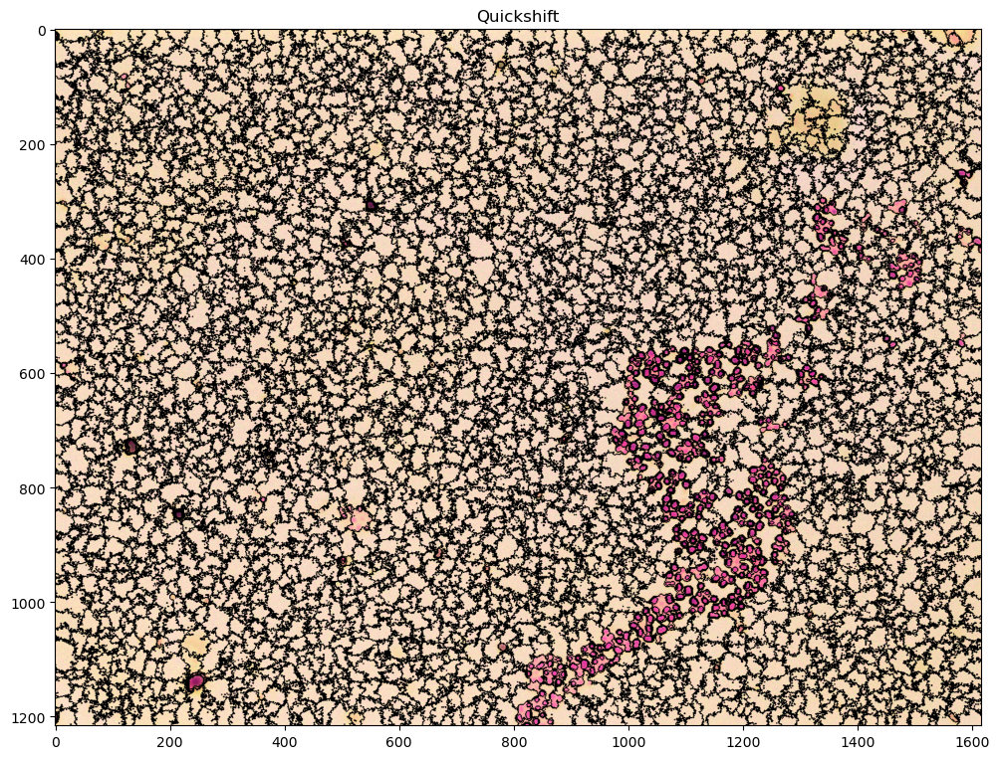

In [27]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('Quickshift')

## Preprocessing image

In [28]:
one_channel_bacteria = af.select_colorsp(bacteria, "green")
one_channel_bacteria.shape

(1216, 1616)

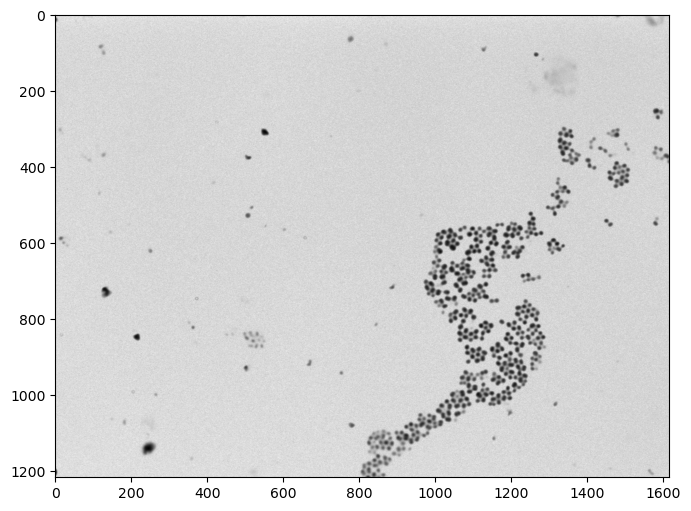

In [29]:
fig, axs = plt.subplots(1, 1, figsize=(17,6))
axs.imshow(one_channel_bacteria, cmap=plt.cm.gray)

In [30]:
np.max(one_channel_bacteria)

255

Text(0.5, 1.0, 'One channel')

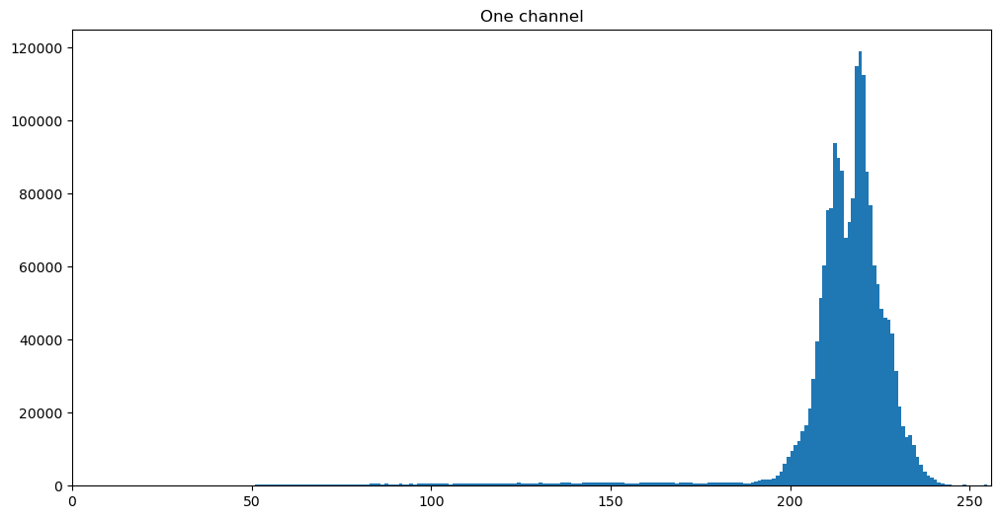

In [31]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")

In [32]:
def Image_with_cumsum(Image, Image_treshhold):
    '''
    Image: uint8 np.asarray(Image.open("Your_image.png"))
    Image_treshhold: float between 0 and 1
    '''
    
    Image_cumsum = np.cumsum(np.histogram(np.uint8(Image).flatten(), bins = np.linspace(0,255,256))[0])
    Image_size = np.shape(Image)[0]*np.shape(Image)[1]
    
    Value_min = 0
    for el in Image_cumsum:
        if Image_size * Image_treshhold <= el:
            Value_min += 1
            break
        Value_min += 1
        
    Value_max = 255
    for el in np.flip(Image_size - Image_cumsum):
        if Image_size * Image_treshhold <= el:
            Value_max -= 1
            break
        Value_max -= 1
    
    Image_cumsum = np.zeros((np.shape(Image)))

    for i in range(np.shape(Image)[0]):
        for j in range(np.shape(Image)[1]):
            if Image[i,j] <= Value_min:
                Image_cumsum[i,j] = Value_min
            elif Image[i,j] >= Value_max:
                Image_cumsum[i,j] = Value_max
            else:
                Image_cumsum[i,j] = Image[i,j]
    
    return Image_cumsum

In [33]:
one_channel_bacteria_cumsum = Image_with_cumsum(one_channel_bacteria, 0.03)

Text(0.5, 1.0, 'One channel')

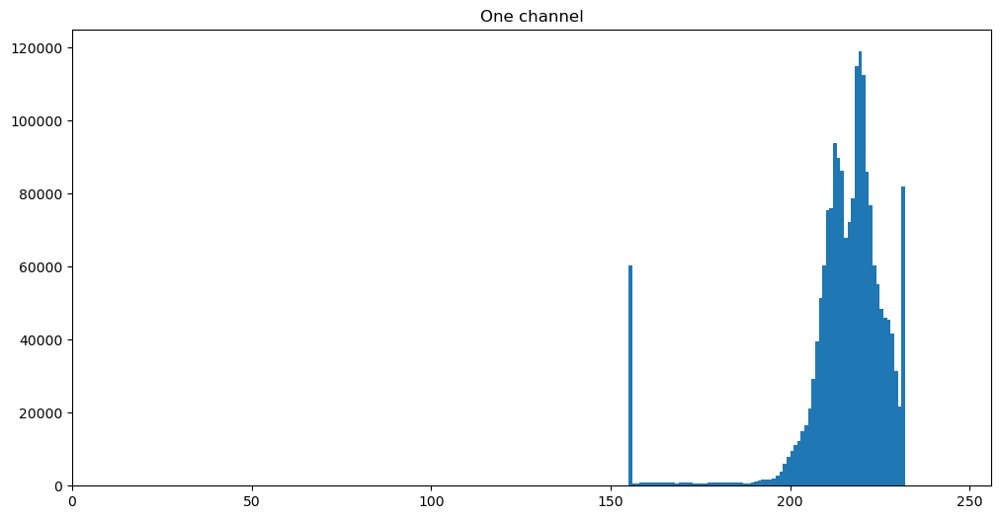

In [34]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria_cumsum.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")

In [35]:
a = 255/(max(one_channel_bacteria_cumsum[:,:].flatten()) - min(one_channel_bacteria_cumsum[:,:].flatten()))
b = 255*(-min(one_channel_bacteria_cumsum[:,:].flatten()))/(max(one_channel_bacteria_cumsum[:,:].flatten()) - min(one_channel_bacteria_cumsum[:,:].flatten()))
LUT = np.array([np.uint8(a*el+b) for el in np.linspace(0,255,256)])

In [36]:
one_channel_bacteria_cumsum_LUT = np.zeros((np.shape(one_channel_bacteria_cumsum)))

for i in range(np.shape(one_channel_bacteria_cumsum)[0]):
    for j in range(np.shape(one_channel_bacteria_cumsum)[1]):
        one_channel_bacteria_cumsum_LUT[i,j] = LUT[np.uint8(one_channel_bacteria_cumsum[i,j])]

Text(0.5, 1.0, 'One channel')

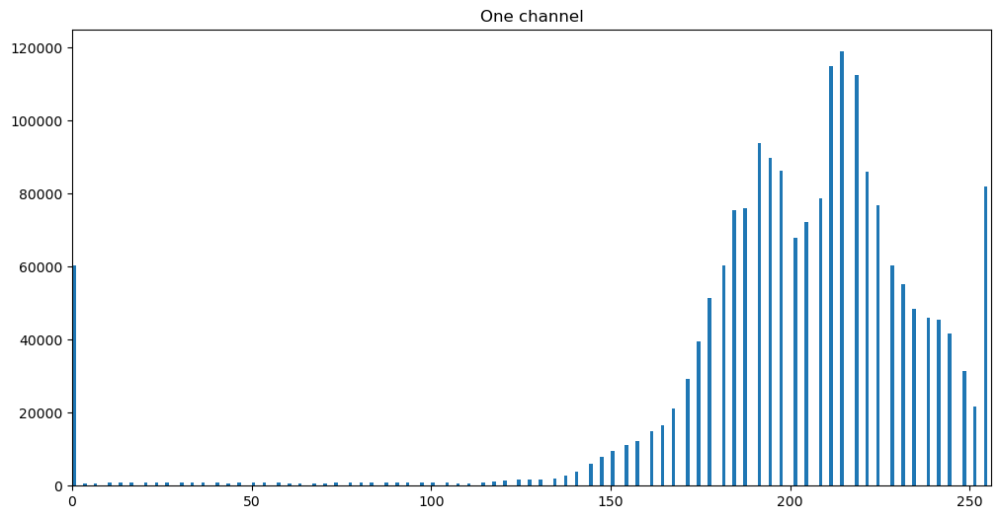

In [37]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria_cumsum_LUT.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")

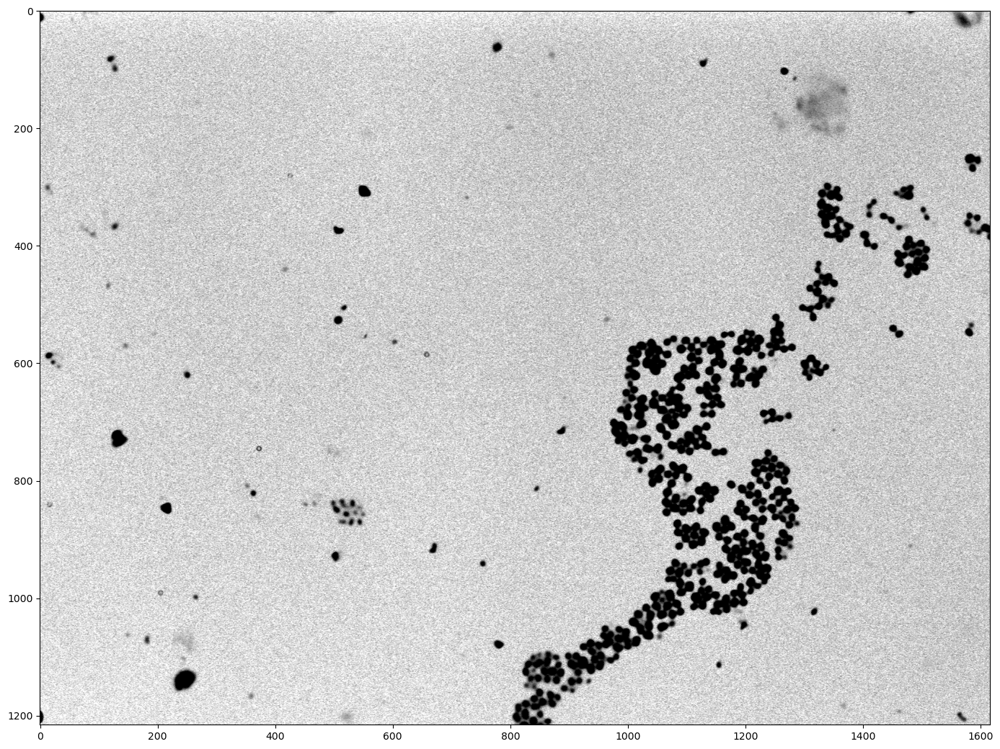

In [38]:
fig, axs = plt.subplots(1, 1, figsize=(17,15))
axs.imshow(one_channel_bacteria_cumsum_LUT, cmap=plt.cm.gray)

In [39]:
af.morph_op(one_channel_bacteria_cumsum_LUT, 'close')

array([[255., 255., 255., ..., 255., 255., 255.],
       [221., 255., 255., ..., 255., 255., 255.],
       [221., 221., 221., ..., 248., 251., 255.],
       ...,
       [ 73., 184., 187., ..., 248., 238., 238.],
       [187., 224., 221., ..., 238., 238., 238.],
       [234., 234., 255., ..., 238., 238., 238.]])

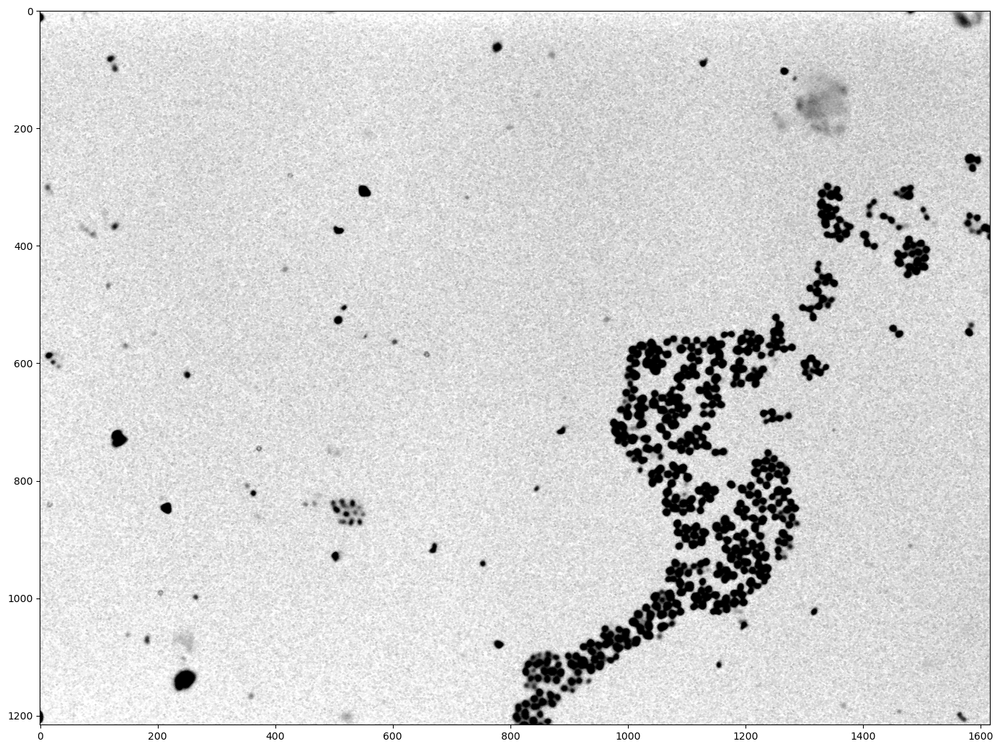

In [40]:
fig, axs = plt.subplots(1, 1, figsize=(17,15))
axs.imshow(af.morph_op(one_channel_bacteria_cumsum_LUT, 'close', 3), cmap=plt.cm.gray)

In [41]:
one_channel_bacteria = cv2.cvtColor(bacteria, cv2.COLOR_BGR2LAB)[:,:,1]
one_channel_bacteria.shape

(1216, 1616)

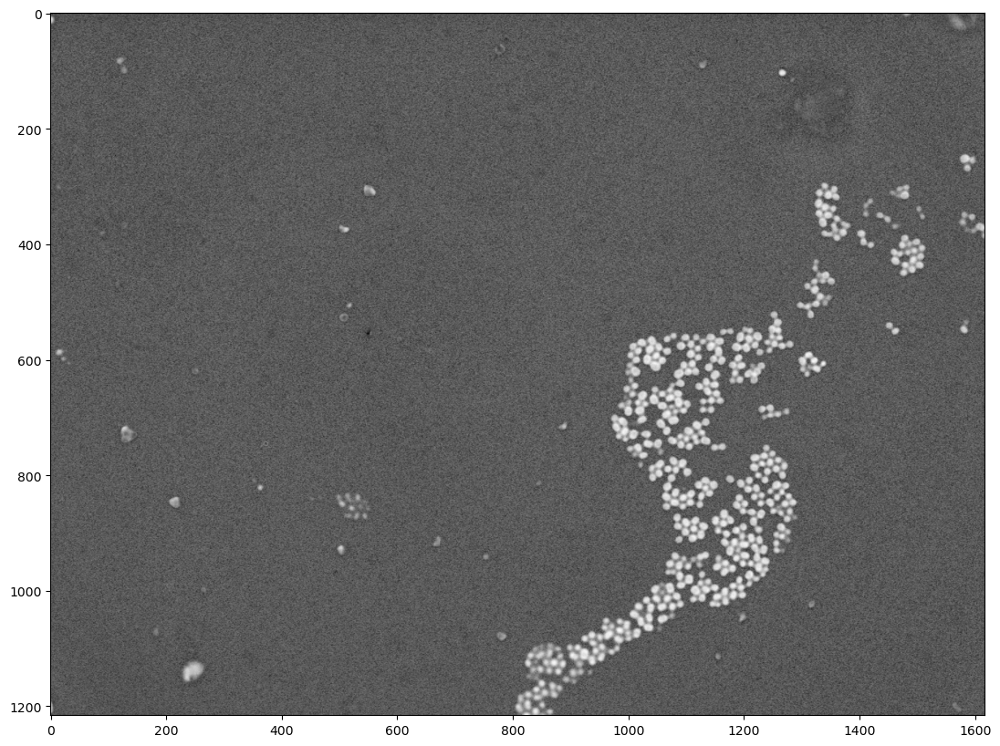

In [42]:
fig, axs = plt.subplots(1, 1, figsize=(17,10))
axs.imshow(one_channel_bacteria, cmap=plt.cm.gray)

Text(0.5, 1.0, 'One channel')

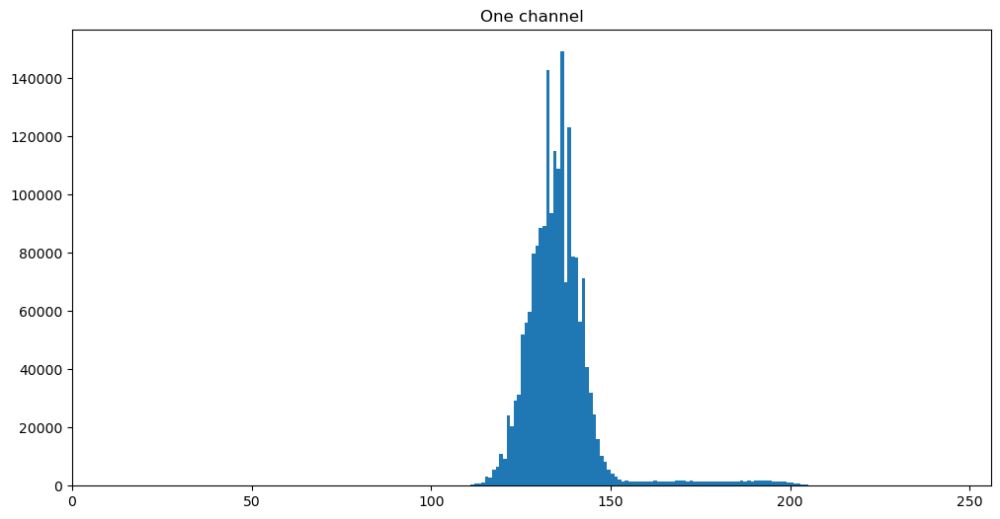

In [43]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")

In [44]:
noise_array = []
for i in range(one_channel_bacteria.shape[0]):
    for j in range(one_channel_bacteria.shape[1]):
        if one_channel_bacteria[i][j] <= 155:
            noise_array.append(one_channel_bacteria[i][j])

In [45]:
print(np.mean(noise_array))
print(np.sqrt(np.var(noise_array)))

133.77522314662352
6.490720355694458


In [46]:
one_channel_sureground_bacteria = one_channel_bacteria.copy()

In [47]:
for i in range(one_channel_bacteria.shape[0]):
    for j in range(one_channel_bacteria.shape[1]):
        if one_channel_bacteria[i][j] <= 153:
            one_channel_sureground_bacteria[i][j] = 0

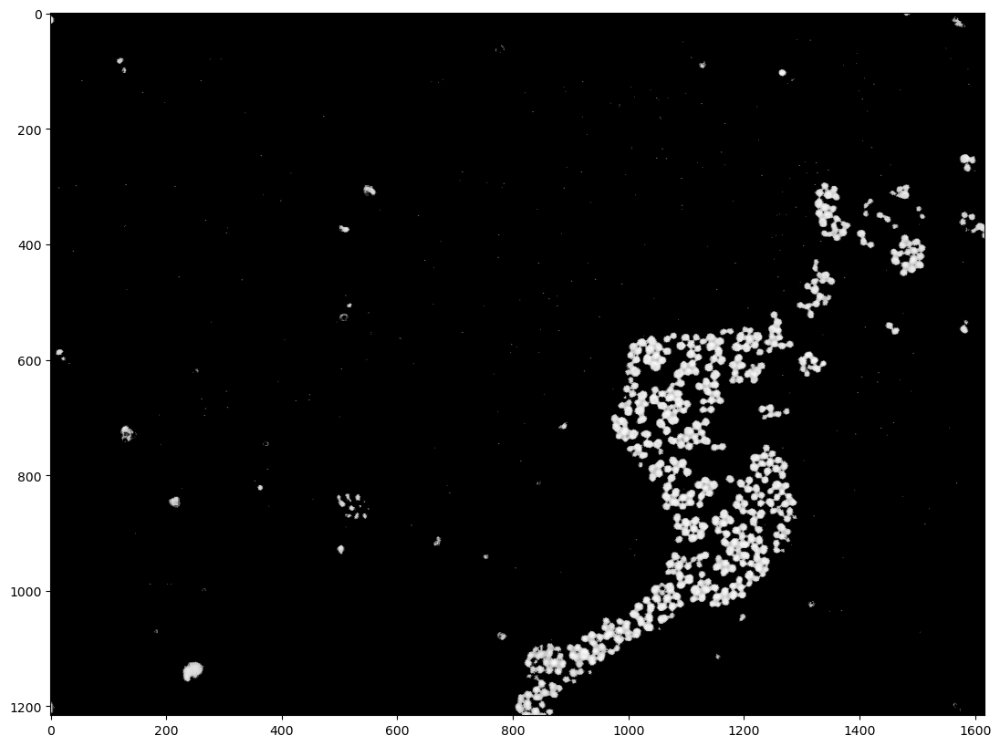

In [48]:
fig, axs = plt.subplots(1, 1, figsize=(17,10))
# cv2.bitwise_not
axs.imshow(one_channel_sureground_bacteria, cmap=plt.cm.gray)

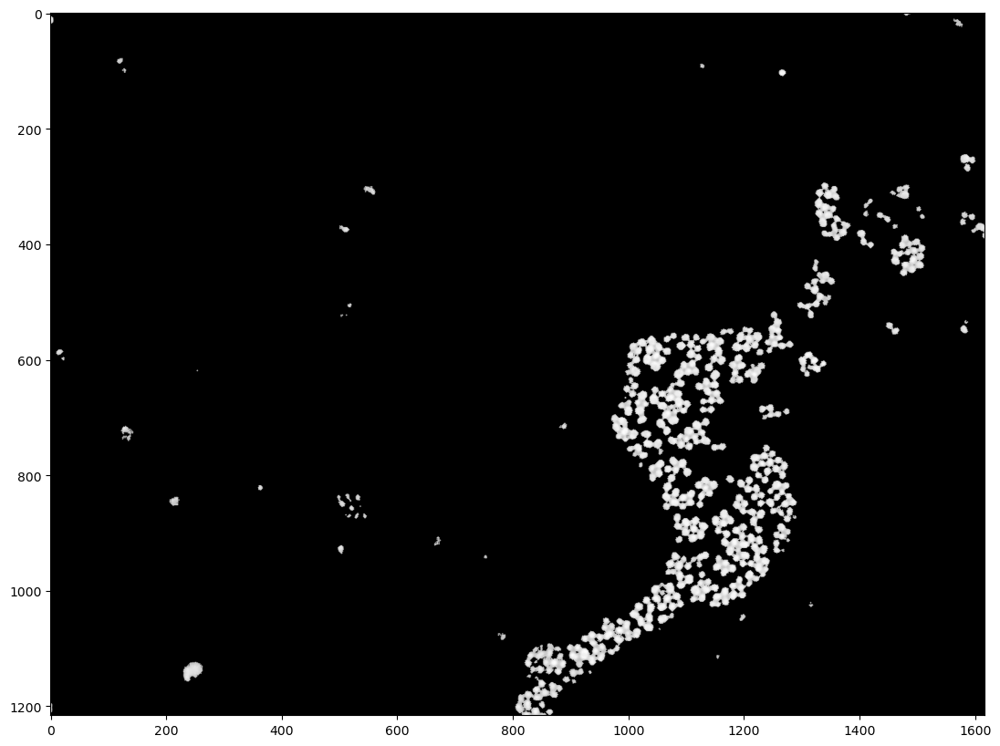

In [49]:
fig, axs = plt.subplots(1, 1, figsize=(17,10))
axs.imshow(af.morph_op(one_channel_sureground_bacteria, 'open', ksize=3), cmap=plt.cm.gray)

In [50]:
one_channel_sureground_opened_bacteria = af.morph_op(one_channel_sureground_bacteria, 'open', ksize=3)

## Segmenting preprocessed image with watershed

Text(0.5, 1.0, 'Sobel')

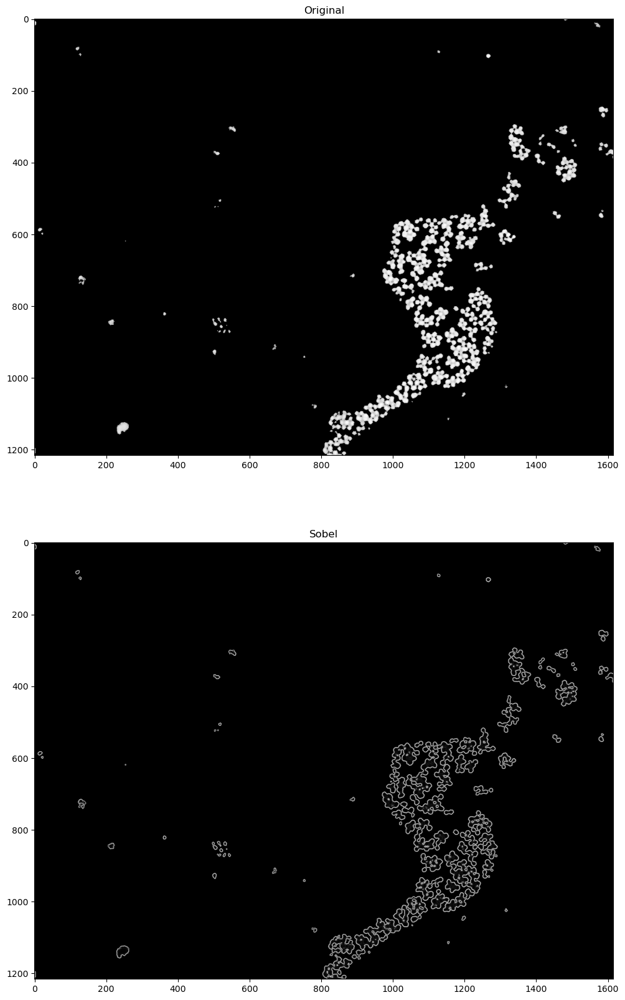

In [51]:
fig, axs = plt.subplots(2, 1, figsize=(16,20))
axs[0].imshow(one_channel_sureground_opened_bacteria, cmap=plt.cm.gray)
axs[0].set_title('Original')
axs[1].imshow(sobel(one_channel_sureground_opened_bacteria), cmap=plt.cm.gray)
axs[1].set_title('Sobel')

In [52]:
one_channel_bacteria_labels = watershed(sobel(one_channel_sureground_opened_bacteria))
# one_channel_bacteria_labels = watershed(one_channel_bacteria)

In [53]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]])

In [54]:
np.max(one_channel_bacteria_labels)

4563

Text(0.5, 1.0, 'Watershed')

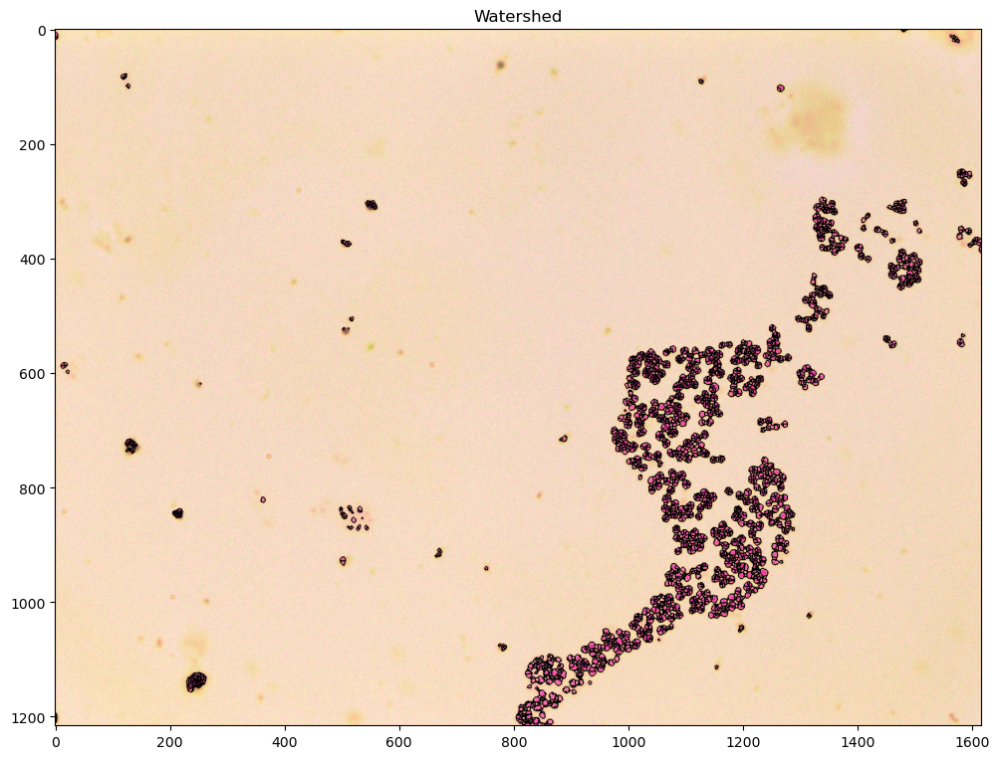

In [55]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('Watershed')

## Segmenting preprocessed image with other algorithms

In [56]:
one_channel_bacteria_labels = felzenszwalb(one_channel_sureground_opened_bacteria)

In [57]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [973, 973, 973, ...,   0,   0,   0],
       [973, 973, 973, ...,   0,   0,   0],
       [973, 973, 973, ...,   0,   0,   0]], dtype=int64)

In [58]:
np.max(one_channel_bacteria_labels)

985

Text(0.5, 1.0, "Felzenszwalbs's method")

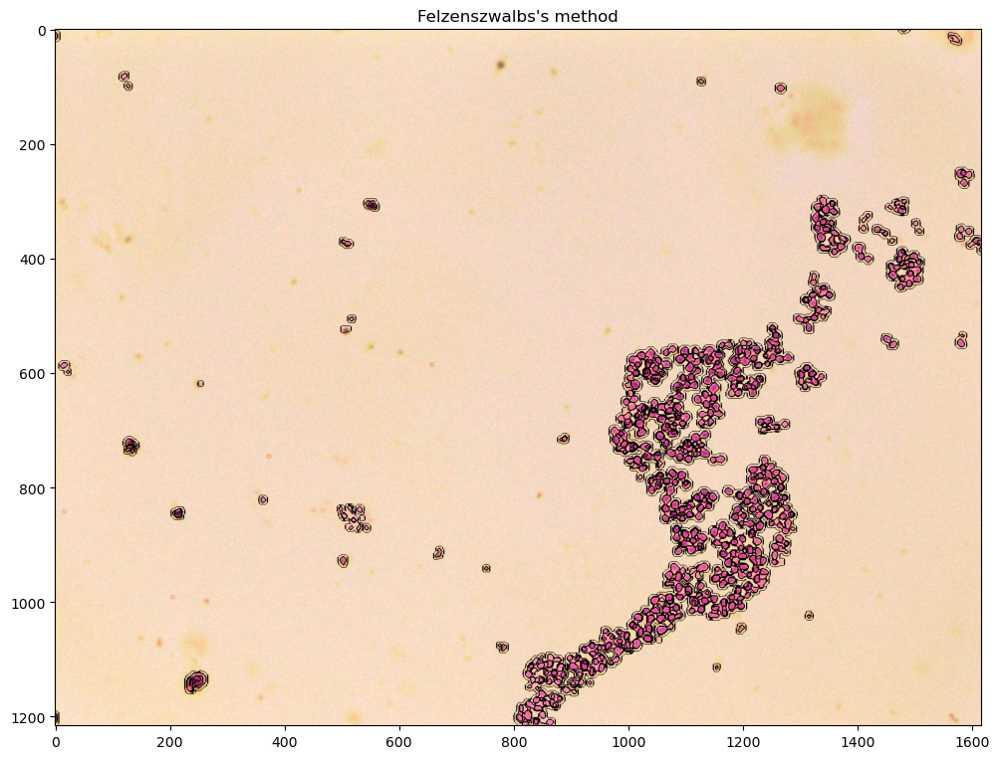

In [59]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('Felzenszwalbs\'s method')

In [60]:
one_channel_bacteria_labels = quickshift(bacteria, convert2lab=True)

In [61]:
print(one_channel_bacteria_labels.shape)
one_channel_bacteria_labels

(1216, 1616)


array([[  13,   13,   13, ...,  118,  118,  118],
       [  13,   13,   13, ...,  118,  118,  118],
       [  13,   13,   13, ...,  118,  118,  118],
       ...,
       [4209, 4209, 4130, ..., 4157, 4157, 4157],
       [4204, 4130, 4130, ..., 4157, 4157, 4157],
       [4130, 4130, 4130, ..., 4157, 4157, 4157]], dtype=int64)

In [62]:
np.max(one_channel_bacteria_labels)

4215

Text(0.5, 1.0, 'Quickshift')

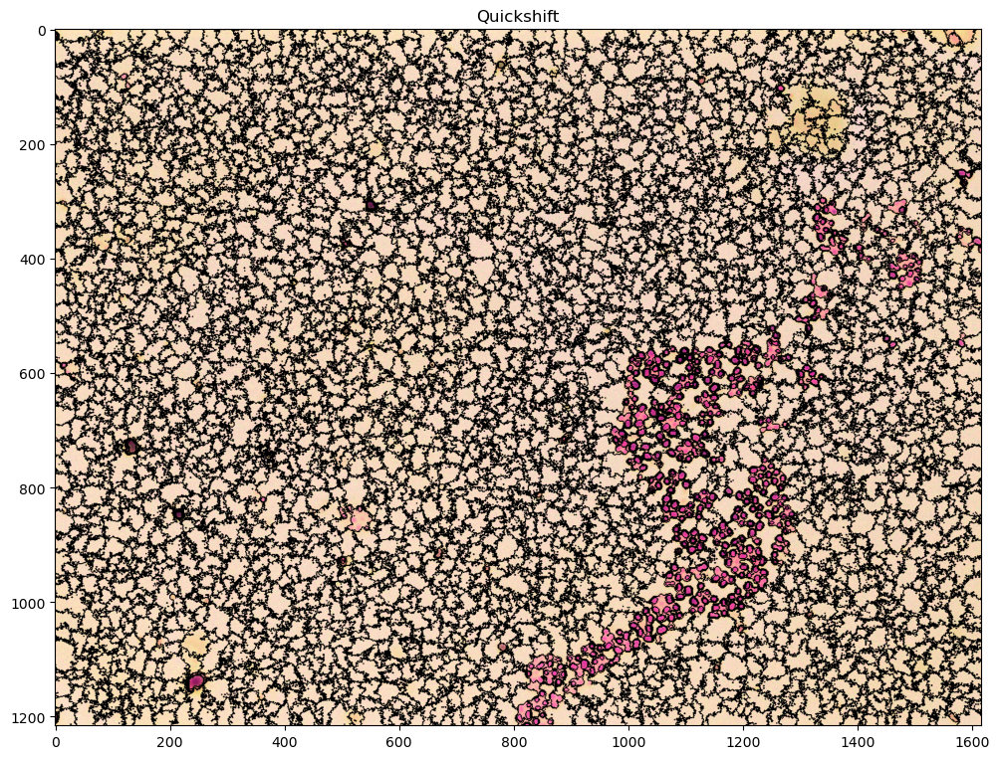

In [63]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
axs.set_title('Quickshift')

In [64]:
bacteria.shape

(1216, 1616, 3)

In [65]:
# one_channel_bacteria_labels = random_walker(bacteria, one_channel_sureground_opened_bacteria, channel_axis = -1)

In [66]:
# print(one_channel_bacteria_labels.shape)
# one_channel_bacteria_labels

In [67]:
# np.max(one_channel_bacteria_labels)

In [68]:
# fig, axs = plt.subplots(1, 1, figsize=(12,10))
# axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels, color=(0, 0, 0)))
# axs.set_title('Random walker')

## Fast scanning algorithm

In [69]:
def Fast_scanning_alg(image, threshold):

    R = np.ones_like(image)*-1
    A = []
    B = []
    image = image.astype(float)

    # IC = []
    
    time_stamp = 0.1
    
    for i in range(image.shape[0]): # main steps
        for j in range(image.shape[1]):
            if (i*image.shape[1] + j)/(image.shape[0]*image.shape[1]) > time_stamp:
                print(time_stamp)
                time_stamp += 0.1
            if i == 0:
                if i == 0 and j == 0:
                    R[i,j] = 0
                    A.append(image[i,j])
                    B.append(1)
                    # IC.append([(i, j)])
                else:
                    left_class = R[i,j-1]
                    if np.abs(image[i,j] - A[left_class]) <= threshold:
                        R[i,j] = left_class
                        A[left_class] = (A[left_class]*B[left_class] + image[i,j])/(B[left_class] + 1)
                        B[left_class] += 1
                        # IC[left_class].append((i, j))
                    else:
                        R[i,j] = left_class + 1
                        A.append(image[i,j])
                        B.append(1)
                        left_class += 1
                        # IC.append([(i, j)])
            else:
                if j == 0:
                    upper_class = R[i-1,j]
                    if np.abs(image[i,j] - A[upper_class]) <= threshold:
                        R[i,j] = upper_class
                        A[upper_class] = (A[upper_class]*B[upper_class] + image[i,j])/(B[upper_class] + 1)
                        B[upper_class] += 1
                        # IC[upper_class].append((i, j))
                    else:
                        R[i,j] = upper_class + 1
                        A.append(image[i,j])
                        B.append(1)
                        upper_class += 1
                        # IC.append([(i, j)])
                else:
                    left_class = R[i,j-1]
                    upper_class = R[i-1,j]
                    if np.abs(image[i,j] - A[upper_class]) <= threshold and np.abs(image[i,j] - A[left_class]) > threshold:
                        R[i,j] = upper_class
                        A[upper_class] = (A[upper_class]*B[upper_class] + image[i,j])/(B[upper_class] + 1)
                        B[upper_class] += 1
                        # IC[upper_class].append((i, j))
                    elif np.abs(image[i,j] - A[upper_class]) > threshold and np.abs(image[i,j] - A[left_class]) <= threshold:
                        R[i,j] = left_class
                        A[left_class] = (A[left_class]*B[left_class] + image[i,j])/(B[left_class] + 1)
                        B[left_class] += 1
                        # IC[left_class].append((i, j))
                    elif np.abs(image[i,j] - A[upper_class]) > threshold and np.abs(image[i,j] - A[left_class]) > threshold:
                        R[i,j] = left_class + 1
                        A.append(image[i,j])
                        B.append(1)
                        left_class += 1
                        # IC.append([(i, j)])
                    elif np.abs(image[i,j] - A[upper_class]) <= threshold and np.abs(image[i,j] - A[left_class]) <= threshold:
                        if left_class == upper_class:
                            R[i,j] = upper_class
                            A[upper_class] = (A[upper_class]*B[upper_class] + image[i,j])/(B[upper_class] + 1)
                            B[upper_class] += 1
                            # IC[upper_class].append((i, j))
                        else:
                            R[i,j] = upper_class
                            A[upper_class] = (A[left_class]*B[left_class] + A[upper_class]*B[upper_class] + image[i,j])/(B[left_class] + B[upper_class] + 1)
                            B[upper_class] += B[left_class] + 1
                            B[left_class] = 0
                            # for i_ch, j_ch in IC[left_class]:
                            #     R[i_ch,j_ch] = upper_class
                            #     IC[upper_class].append((i, j))

                            for j_inv in range(j-1,-1,-1):
                                if R[i,j_inv] == left_class:
                                        R[i,j_inv] = upper_class

                            for i_inv in range(i-1,-1,-1):
                                flag = True
                                for j_inv in range(0,1,image.shape[1]):
                                    if R[i_inv,j_inv] == left_class:
                                        R[i_inv,j_inv] = upper_class
                                        flag = False
                                if flag == True:
                                    # print("ended")
                                    break

    ### CAN ADD MERGIRNG STEP

    return R

In [70]:
one_channel_bacteria_labels_fast = Fast_scanning_alg(one_channel_sureground_opened_bacteria, 30)

0.1
0.2
0.30000000000000004
0.4
0.5
0.6
0.7
0.7999999999999999
0.8999999999999999


In [71]:
print(one_channel_bacteria_labels_fast.shape)
one_channel_bacteria_labels_fast

(1216, 1616)


array([[ 2,  0,  0, ...,  2,  2,  2],
       [ 2,  0,  0, ...,  2,  2,  2],
       [ 2,  0,  0, ...,  2,  2,  2],
       ...,
       [ 8, 12, 13, ...,  7,  7,  7],
       [ 9, 10, 11, ...,  7,  7,  7],
       [10, 11, 12, ...,  7,  7,  7]], dtype=int16)

In [72]:
np.max(one_channel_bacteria_labels_fast)

44

Text(0.5, 1.0, 'Fast scan')

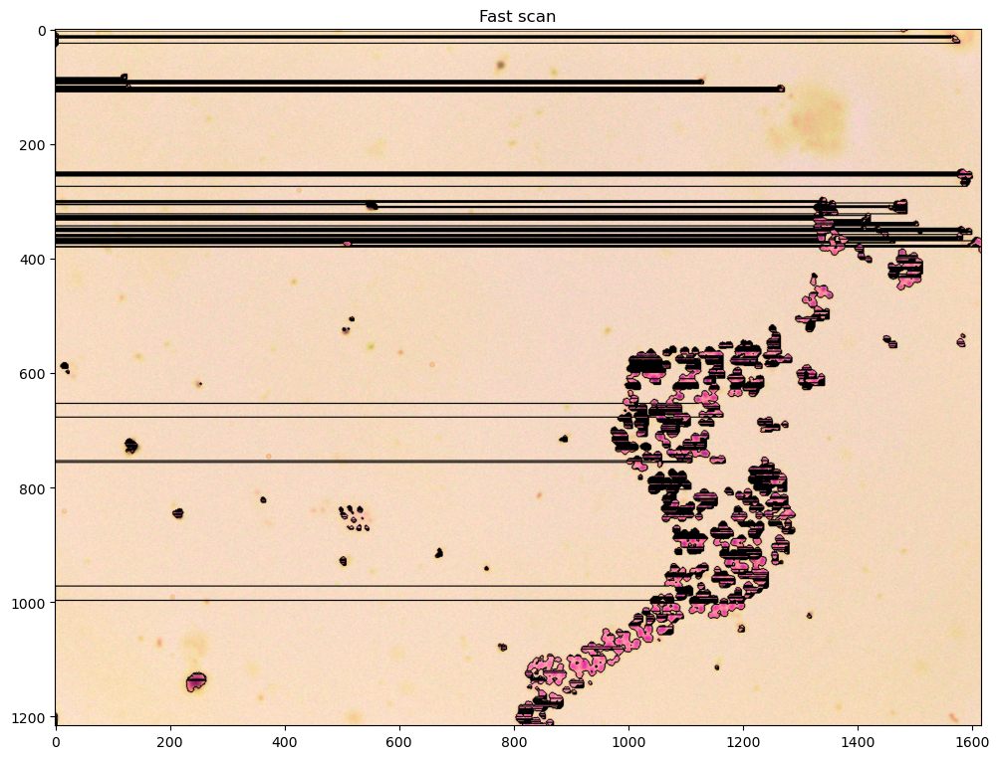

In [73]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_labels_fast, color=(0, 0, 0)))
axs.set_title('Fast scan')

In [74]:
# values, counts = np.unique(one_channel_bacteria_labels_fast, return_counts=True)
# dtype = [('values', int), ('counts', int)]
# values_counts = np.array([(val, cnt) for val, cnt in zip(values, counts)], dtype=dtype)
# values_counts_sorted = np.sort(values_counts, order = 'counts')[::-1]
# values_counts_sorted

In [75]:
# labels_num = 50

# fig, axs = plt.subplots(1, 1, figsize=(17, 10))

# one_channel_bacteria_copy = one_channel_bacteria.copy()
# checked_labels =[el for el,_ in values_counts_sorted[1:labels_num]]
# for i_i in range(one_channel_bacteria_copy.shape[0]):
#     for i_j in range(one_channel_bacteria_copy.shape[1]):
#         if one_channel_bacteria_labels_fast[i_i][i_j] in checked_labels:
#             one_channel_bacteria_copy[i_i][i_j] = 255

# axs.imshow(one_channel_bacteria_copy, cmap=plt.cm.gray)
# axs.set_title(f"First {labels_num} labels")

## Testing normality of the noise

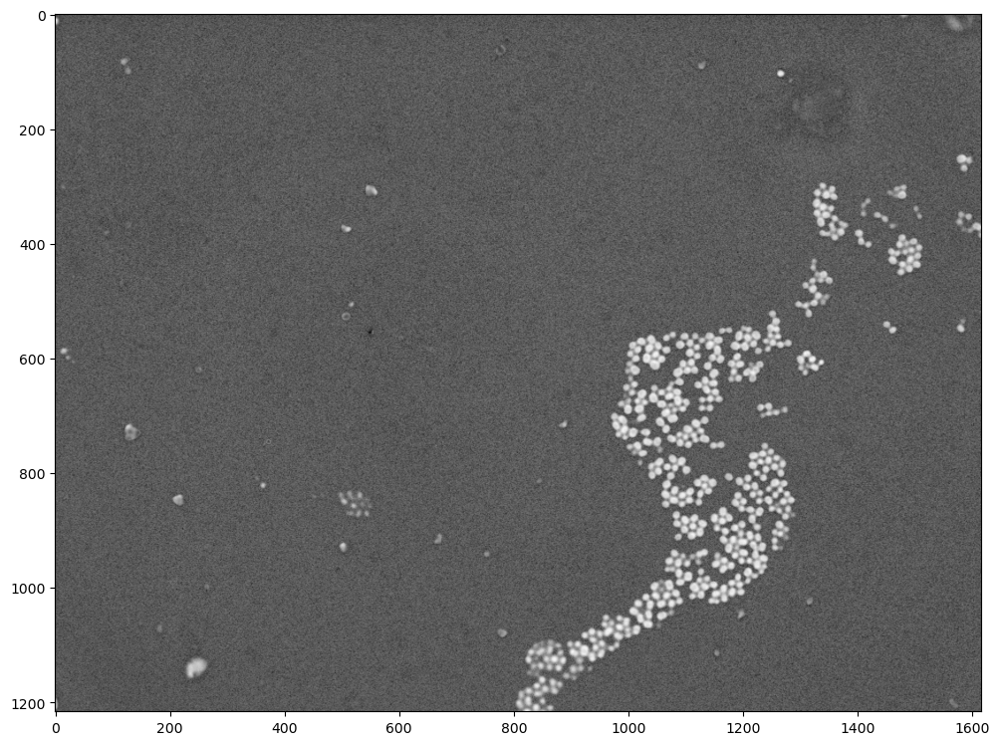

In [77]:
fig, axs = plt.subplots(1, 1, figsize=(12,10))
axs.imshow(one_channel_bacteria, cmap=plt.cm.gray)

In [88]:
noise_array = []
for i in range(one_channel_bacteria.shape[0]):
    for j in range(one_channel_bacteria.shape[1]):
        if one_channel_bacteria[i][j] <= 153:
            noise_array.append(one_channel_bacteria[i][j])

In [89]:
print(np.mean(noise_array))
print(np.sqrt(np.var(noise_array)))

133.73964253199537
6.4391837081074


Text(0.5, 1.0, 'Noise')

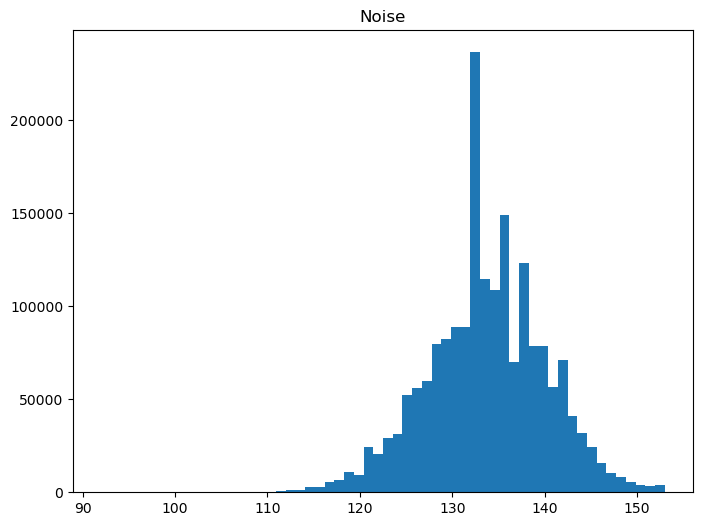

In [101]:
fig, axs = plt.subplots(1, 1, figsize=(8,6))

axs.hist(noise_array, bins = len(np.unique(noise_array)))
axs.set_title("Noise")

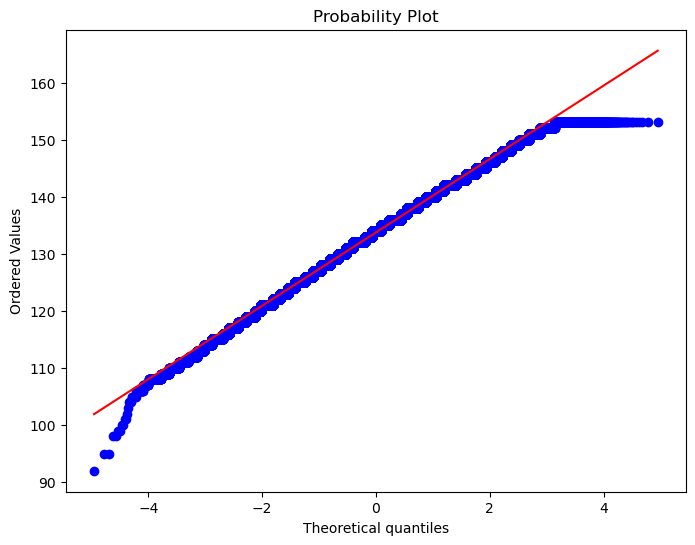

In [90]:
fig, axs = plt.subplots(1, 1, figsize=(8,6))
stats.probplot(noise_array, dist="norm", plot=axs)

plt.show()

In [102]:
stats.shapiro(noise_array)

c:\Users\egork\miniconda3\lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.9962706565856934, pvalue=0.0)

In [103]:
stats.normaltest(noise_array)

NormaltestResult(statistic=7210.279072099684, pvalue=0.0)

In [104]:
stats.anderson(noise_array)

AndersonResult(statistic=2763.095366755966, critical_values=array([0.576, 0.656, 0.787, 0.918, 1.092]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=133.73964253199537, scale=6.439185411279526)
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

In [106]:
stats.jarque_bera(noise_array)

SignificanceResult(statistic=7292.874584362162, pvalue=0.0)

## Testing a "derivative histogram" idea

In [2]:
bacteria = cv2.imread('test_input_1.bmp')

In [4]:
one_channel_bacteria = cv2.cvtColor(bacteria, cv2.COLOR_BGR2LAB)[:,:,0]
one_channel_bacteria.shape

(1216, 1616)

In [6]:
one_channel_bacteria_filtered = cv2.GaussianBlur(one_channel_bacteria, (5,5), 0)

Text(0.5, 1.0, 'One channel')

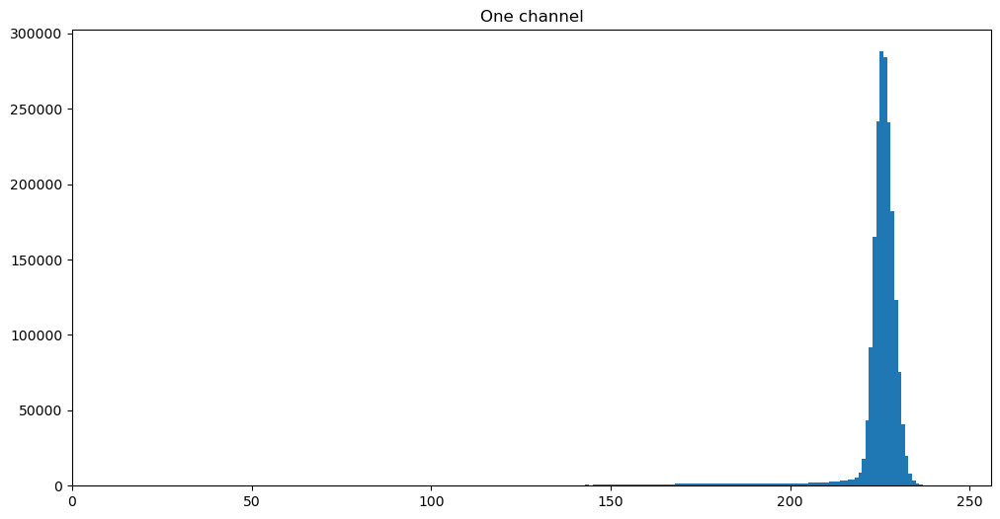

In [7]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria_filtered.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")

In [15]:
histogram_array = np.histogram(one_channel_bacteria_filtered.flatten(), bins=[el for el in range(256)], range=(0,256))[0]
histogram_array

array([     0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      1,      1,      4,
            2,      1,      2,      4,      4,      1,      1,      2,
            3,      6,      4,      7,      8,      9,      9,      7,
            6,     16,     10,     11,      8,      9,     11,      6,
            9,     11,     10,     15,     16,     13,     15,     18,
           13,     11,     16,     15,     14,     20,     22,     20,
           12,     12,     12,     16,     16,     13,     17,     30,
           25,     20,     24,     19,     26,     24,     35,     37,
      

In [16]:
np.diff(histogram_array)

array([     0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      0,      0,      0,      0,
            0,      0,      0,      0,      1,      0,      3,     -2,
           -1,      1,      2,      0,     -3,      0,      1,      1,
            3,     -2,      3,      1,      1,      0,     -2,     -1,
           10,     -6,      1,     -3,      1,      2,     -5,      3,
            2,     -1,      5,      1,     -3,      2,      3,     -5,
           -2,      5,     -1,     -1,      6,      2,     -2,     -8,
            0,      0,      4,      0,     -3,      4,     13,     -5,
           -5,      4,     -5,      7,     -2,     11,      2,      7,
      

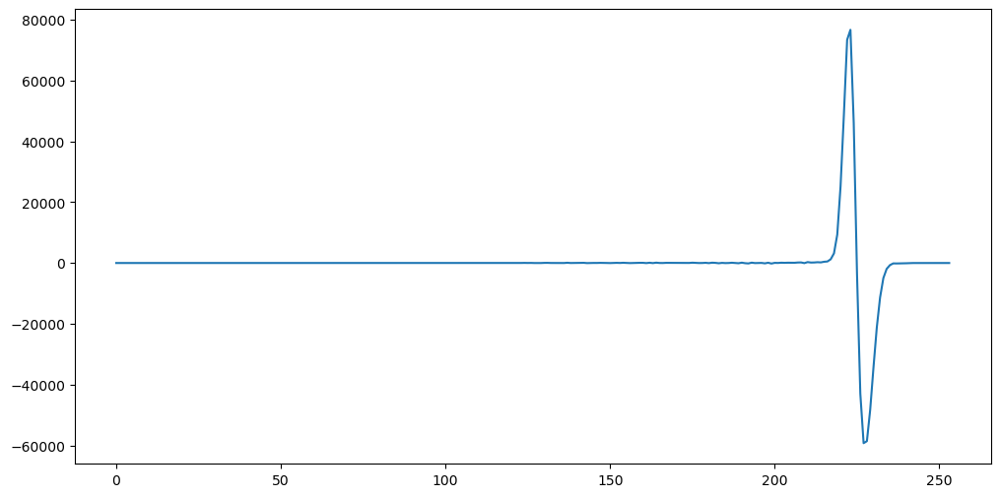

In [18]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.plot(np.diff(histogram_array))

## Compairing channels

In [13]:
one_channel_bacteria = cv2.cvtColor(bacteria, cv2.COLOR_BGR2LAB)[:,:,0]
one_channel_bacteria.shape

(1216, 1616)

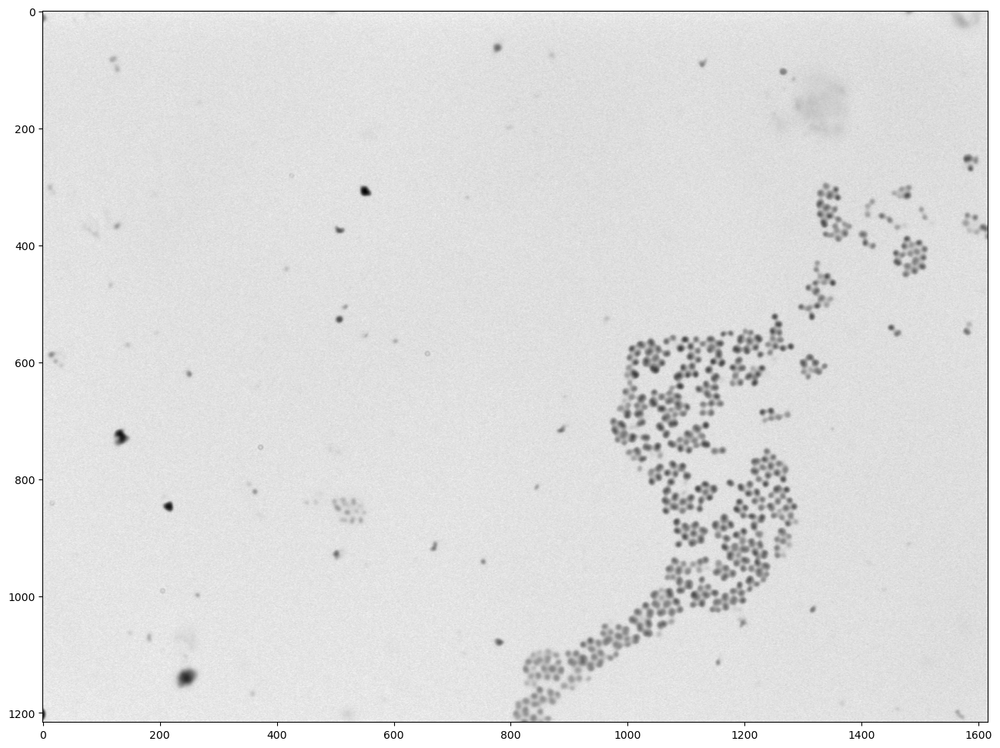

In [14]:
fig, axs = plt.subplots(1, 1, figsize=(16,12))
axs.imshow(one_channel_bacteria, cmap=plt.cm.gray)

In [15]:
one_channel_bacteria = cv2.cvtColor(bacteria, cv2.COLOR_BGR2GRAY)
one_channel_bacteria.shape

(1216, 1616)

In [32]:
bacteria = cv2.imread('test_input_2.bmp')

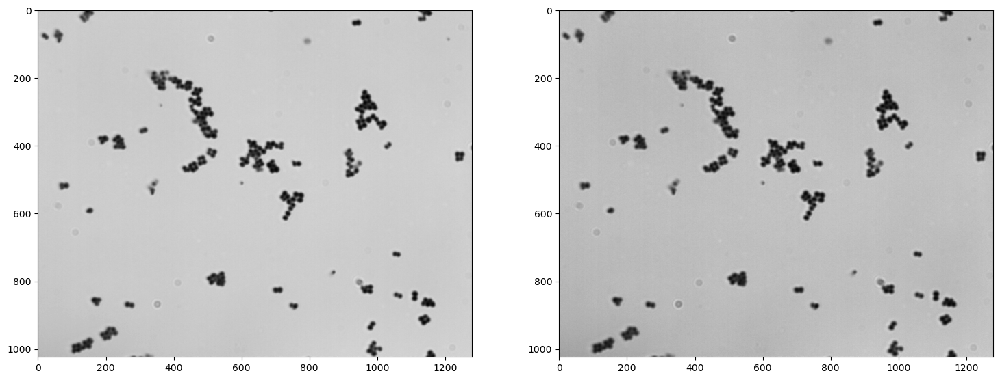

In [33]:
fig, axs = plt.subplots(1, 2, figsize=(18,14))
one_channel_bacteria = cv2.cvtColor(bacteria, cv2.COLOR_BGR2GRAY)
axs[0].imshow(one_channel_bacteria, cmap=plt.cm.gray)

# one_channel_bacteria = cv2.cvtColor(bacteria, cv2.COLOR_BGR2LAB)[:,:,2]
one_channel_bacteria = bacteria[:,:,1]
axs[1].imshow(one_channel_bacteria, cmap=plt.cm.gray)

Text(0.5, 1.0, 'One channel')

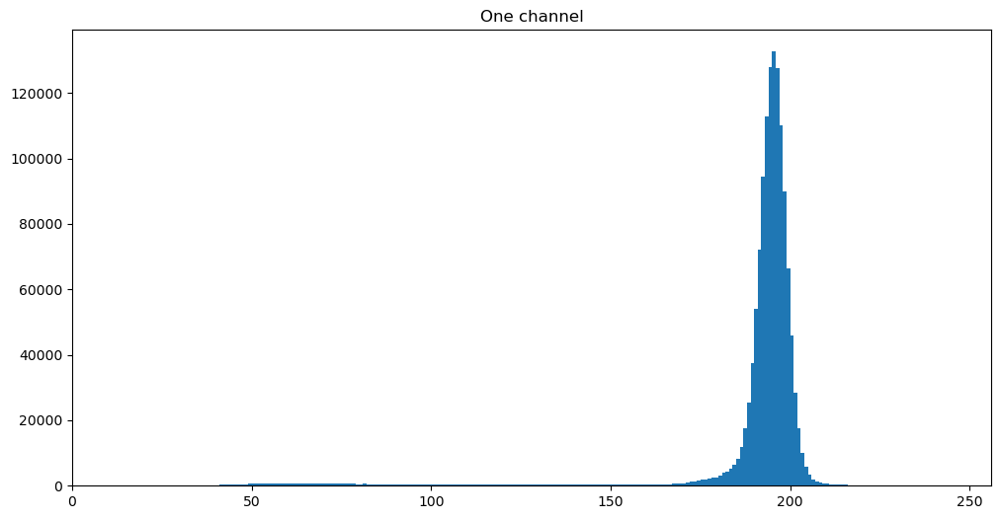

In [34]:
fig, axs = plt.subplots(1, 1, figsize=(12,6))

axs.hist(one_channel_bacteria.flatten(), bins=[el for el in range(256)], range=(0,256))
axs.set_xlim((0, 256))
axs.set_title("One channel")